In [5]:
from solver import System
import torch
import matplotlib.pyplot as plt

In [2]:
N = 128
L = 128#2 * torch.pi
dt = 0.1
steps = 100000
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# device = 'cpu'



In [ ]:
# from solver import PseudoSpectralSolver2D
# import time

# solver = PseudoSpectralSolver2D( N, L, dt=dt, device=device,record_every_n_steps = steps//100)


# a = -1
# b = 1
# k = 4

# solver.set_initial_condition(0.1 * torch.randn(N, N, device=device))
# solver.set_linear_func(lambda qx,qy,q2: -q2 * (a + k*q2))
# solver.set_nonlinear_func(lambda qx,qy,q2,u: -q2 * b * torch.fft.fft2(u**3))

# start = time.time()
# traj = solver.run(steps)
# end = time.time()
# print(f"Elapsed time: {end - start:.2f} seconds")

Elapsed time: 5.23 seconds


In [31]:
def init_u(N):
    u = torch.ones(N, N)
    r = 10  # half size of perturbation square
    u[N//2 - r:N//2 + r, N//2 - r:N//2 + r] = 0.50
    u += 0.02 * torch.randn(N, N)
    return u

def init_v(N):
    v = torch.zeros(N, N)
    r = 10
    v[N//2 - r:N//2 + r, N//2 - r:N//2 + r] = 0.25
    v += 0.02 * torch.randn(N, N)
    return v

In [12]:
import time

solver = System(N=N, L=L, dt=dt, device=device, record_every_n_steps = steps/100)

a = -1
b = 1
k = 4

# # --- Add active fields ---
solver.model.add_active_field(
    "u",
    init = 0.1 * torch.randn((N, N)),
    L_hat = -solver.q2 * (a + k*solver.q2),
    N_hat = lambda R: -solver.q2 * b * torch.fft.fft2(R["u"].f**3)
)
# --- Add active fields ---
du = 0.16
dv = 0.08
F = 0.06
k = 0.062

# solver.model.add_active_field(
#     "u",
#     init = init_u(N),
#     L_hat = -solver.q2 * (du),
#     N_hat = lambda R: torch.fft.fft2(-R["u"].f * R["v"].f**2 + F * (1 - R["u"].f))
# )
# # --- Add active fields ---
# solver.model.add_active_field(
#     "v",
#     init =  init_v(N),
#     L_hat = -solver.q2 * (dv),
#     N_hat = lambda R: torch.fft.fft2(R["u"].f * R["v"].f**2 - (F + k) * R["v"].f)
# )

traj = []
start = time.time()
for i in range(100):
    solver.run(steps//100)
    traj.append(solver.model.fields['u'].f)
end = time.time()
print(f"Elapsed time: {end - start:.6f} seconds")
traj = torch.stack(traj)

# traj = solver.run(steps)
print(traj.shape)


Elapsed time: 5.465996 seconds
torch.Size([100, 128, 128])


In [33]:
from IPython.display import HTML

import matplotlib.pyplot as plt
import matplotlib.animation as animation

%matplotlib inline

fig, ax = plt.subplots()
im = ax.imshow(traj[0].cpu().numpy(), cmap='viridis', origin='lower', animated=True)
ax.set_title("PseudoSpectralSolver2D Evolution")
cbar = fig.colorbar(im, ax=ax)
cbar.set_label("Field Value")

def update(frame):
    im.set_array(traj[frame].cpu().numpy())
    ax.set_xlabel(f"Step {frame}")
    im.set_clim(vmin=traj[frame].min().cpu().item(), vmax=traj[frame].max().cpu().item())
    cbar.update_normal(im)
    return [im]

ani = animation.FuncAnimation(fig, update, frames=traj.shape[0], blit=True, interval=50)
plt.close(fig)  # Prevents duplicate static plot
display(HTML(ani.to_jshtml()))
print(traj.shape)

torch.Size([100, 128, 128])


In [34]:
traj[55].min()

tensor(-0.9982, device='cuda:0')

In [35]:
print(solver.mask)
print(torch.any(solver.mask == False))

AttributeError: 'System' object has no attribute 'mask'

In [ ]:
k = torch.fft.fftfreq(N,d=1/N).to(device)
# print(k)
kx, ky = torch.meshgrid(k, k, indexing="ij")
# mask = ((kx.abs() < N//3) & (ky.abs() < N//3))

print(k)




tensor([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
         12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,  23.,
         24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,  33.,  34.,  35.,
         36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,  45.,  46.,  47.,
         48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,  56.,  57.,  58.,  59.,
         60.,  61.,  62.,  63., -64., -63., -62., -61., -60., -59., -58., -57.,
        -56., -55., -54., -53., -52., -51., -50., -49., -48., -47., -46., -45.,
        -44., -43., -42., -41., -40., -39., -38., -37., -36., -35., -34., -33.,
        -32., -31., -30., -29., -28., -27., -26., -25., -24., -23., -22., -21.,
        -20., -19., -18., -17., -16., -15., -14., -13., -12., -11., -10.,  -9.,
         -8.,  -7.,  -6.,  -5.,  -4.,  -3.,  -2.,  -1.], device='cuda:0')


In [ ]:
kx = torch.fft.fftfreq(N, d=L/N).to(device) * 2 * torch.pi
ky = torch.fft.rfftfreq(N, d=L/N).to(device) * 2 * torch.pi
kx, ky = torch.meshgrid(kx, ky, indexing='ij')

In [ ]:
kx,kx.shape

(tensor([[ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
         [ 0.0245,  0.0245,  0.0245,  ...,  0.0245,  0.0245,  0.0245],
         [ 0.0491,  0.0491,  0.0491,  ...,  0.0491,  0.0491,  0.0491],
         ...,
         [-0.0736, -0.0736, -0.0736,  ..., -0.0736, -0.0736, -0.0736],
         [-0.0491, -0.0491, -0.0491,  ..., -0.0491, -0.0491, -0.0491],
         [-0.0245, -0.0245, -0.0245,  ..., -0.0245, -0.0245, -0.0245]],
        device='cuda:0'),
 torch.Size([128, 65]))

In [ ]:
u = traj[10]
u_hat = torch.fft.rfft2(u)
print(u_hat.shape)
un = torch.fft.irfft2(u_hat)
print(un.shape)
u_hat[1,1],u_hat[-1,-1]

torch.Size([128, 65])
torch.Size([128, 128])


(tensor(-1226.3015-526.2800j), tensor(3.4542e-07-4.8536e-08j))

In [ ]:
un,u

(tensor([[1.0105, 1.0029, 1.0101,  ..., 1.0076, 1.0051, 1.0124],
         [1.0060, 1.0037, 1.0114,  ..., 1.0082, 1.0039, 1.0090],
         [1.0107, 1.0105, 1.0116,  ..., 1.0056, 1.0048, 1.0123],
         ...,
         [1.0087, 1.0011, 1.0064,  ..., 1.0058, 1.0030, 1.0080],
         [1.0069, 1.0017, 1.0086,  ..., 1.0071, 1.0013, 1.0049],
         [1.0125, 1.0062, 1.0121,  ..., 1.0063, 1.0015, 1.0090]]),
 tensor([[1.0105, 1.0029, 1.0101,  ..., 1.0076, 1.0051, 1.0124],
         [1.0060, 1.0037, 1.0114,  ..., 1.0082, 1.0039, 1.0090],
         [1.0107, 1.0105, 1.0116,  ..., 1.0056, 1.0048, 1.0123],
         ...,
         [1.0087, 1.0011, 1.0064,  ..., 1.0058, 1.0030, 1.0080],
         [1.0069, 1.0017, 1.0086,  ..., 1.0071, 1.0013, 1.0049],
         [1.0125, 1.0062, 1.0121,  ..., 1.0063, 1.0015, 1.0090]]))

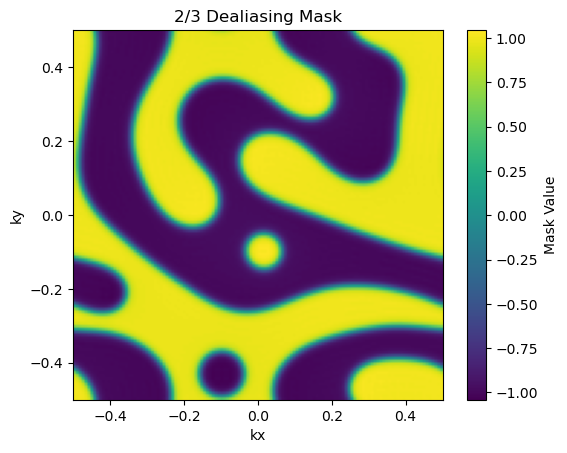

In [ ]:
plt.imshow(traj[10].cpu(), origin="lower", extent=[-0.5, 0.5, -0.5, 0.5])
plt.title("2/3 Dealiasing Mask")
plt.xlabel("kx")
plt.ylabel("ky")
plt.colorbar(label="Mask Value")